<a href="https://colab.research.google.com/github/dhritiman-dasgupta/dhritiman-dasgupta/blob/master/retinopathy_maskrcnn_semantic_segmentation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

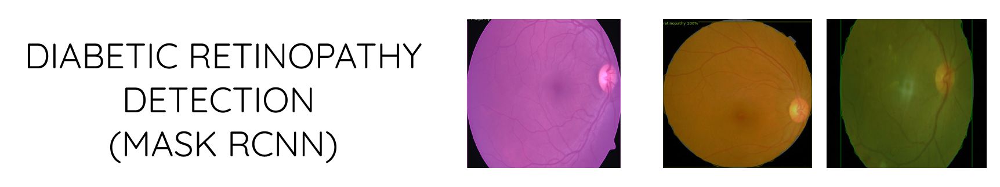
# Introduction to Diabetic Retina Retinopathy Detection using Detectron2 Semantic Segmentation

Diabetic Retinopathy is a serious eye disease that affects individuals with diabetes, potentially leading to vision loss and blindness if not detected and treated in its early stages. The application of advanced computer vision techniques and deep learning has significantly improved the automation and accuracy of diagnosing diabetic retinopathy, making it a vital area of research and development.
**bold text**
This Colab notebook serves as a comprehensive guide for utilizing Detectron2, a powerful object detection and segmentation library, to address the task of diabetic retinopathy detection through semantic segmentation.

## Table of Contents
1. **Data Preprocessing**: We will delve into the process of collecting, cleaning, and preparing a dataset of retinal images to facilitate the training and evaluation of the Detectron2 model. Ensuring data quality is crucial for the model's effectiveness.

2. **Detectron2 Framework**: We'll provide an overview of Detectron2, emphasizing its capabilities for semantic segmentation. This will include an introduction to the model architecture, training pipelines, and configuration.

3. **Model Training**: This section will guide you through the process of training a Detectron2 model on the preprocessed diabetic retinopathy dataset. We will explore strategies for optimizing model performance, fine-tuning, and adjusting hyperparameters.

4. **Inference and Visualization**: After training the model, we will demonstrate how to employ it for inference on new, previously unseen retinal images. You will learn how to visualize segmentation masks produced by the model and extract valuable insights.

5. **Evaluation and Metrics**: To gauge the model's performance accurately, we will introduce common metrics used for assessing semantic segmentation models, such as Intersection over Union (IoU) and Dice coefficient.

6. **Clinical Application**: We will discuss the practical implications of employing Detectron2 for diabetic retinopathy detection in clinical settings. Additionally, we will explore potential avenues for further research and model improvement.

By the end of this Colab, you will have gained a solid understanding of how to harness Detectron2 for semantic segmentation in the context of diabetic retinopathy detection. Equipped with this knowledge and the provided tools, you'll be well-prepared to contribute to the ongoing efforts to automate early diabetic retinopathy diagnosis, ultimately enhancing the quality of care for individuals living with diabetes. Let's embark on this journey towards more accurate and efficient diabetic retinopathy detection together.


## Check the environment Install Detectron2 and dependencies

Let's make sure that we have access to GPU. We can use `nvidia-smi` command to do that. In case of any problems navigate to `Edit` -> `Notebook settings` -> `Hardware accelerator` and set it to `GPU`.

In [ ]:
!nvidia-smi
!python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

##Checking the versions


In [ ]:
import torch, detectron2
!nvcc --version
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)
print("detectron2:", detectron2.__version__)

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2022 NVIDIA Corporation
Built on Wed_Sep_21_10:33:58_PDT_2022
Cuda compilation tools, release 11.8, V11.8.89
Build cuda_11.8.r11.8/compiler.31833905_0
torch:  2.0 ; cuda:  cu118
detectron2: 0.6


##IMPORTING ALL THE REQUIRED LIBRARIES

In [ ]:
# COMMON LIBRARIES
import os
import cv2

from datetime import datetime
from google.colab.patches import cv2_imshow

# DATA SET PREPARATION AND LOADING
from detectron2.data.datasets import register_coco_instances
from detectron2.data import DatasetCatalog, MetadataCatalog

# VISUALIZATION
from detectron2.utils.visualizer import Visualizer
from detectron2.utils.visualizer import ColorMode

# CONFIGURATION
from detectron2 import model_zoo
from detectron2.config import get_cfg

# EVALUATION
from detectron2.engine import DefaultPredictor

# TRAINING
from detectron2.engine import DefaultTrainer

## DATASET DOWNLOADED IN COCO FORMAT

### Download

Structure of our dataset should look like this:

```
dataset-directory/
├─ README.dataset.txt
├─ README.roboflow.txt
├─ train
│  ├─ train-image-1.jpg
│  ├─ train-image-1.jpg
│  ├─ ...
│  └─ _annotations.coco.json
├─ test
│  ├─ test-image-1.jpg
│  ├─ test-image-1.jpg
│  ├─ ...
│  └─ _annotations.coco.json
└─ valid
   ├─ valid-image-1.jpg
   ├─ valid-image-1.jpg
   ├─ ...
   └─ _annotations.coco.json
```

In [ ]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="Dd1XBEwRQ4IIEHvF3lWA")
project = rf.workspace("dhritiman-dasgupta").project("retinopathy-fennd")
dataset = project.version(1).download("coco-segmentation")


### Register

When you use Detectron2, before you actually train the model you need to [register it](https://detectron2.readthedocs.io/en/latest/tutorials/datasets.html#register-a-coco-format-dataset).

In [ ]:
DATA_SET_NAME = dataset.name.replace(" ", "-")
ANNOTATIONS_FILE_NAME = "_annotations.coco.json"

In [ ]:
# TRAIN SET
TRAIN_DATA_SET_NAME = f"{DATA_SET_NAME}-train"
TRAIN_DATA_SET_IMAGES_DIR_PATH = os.path.join(dataset.location, "train")
TRAIN_DATA_SET_ANN_FILE_PATH = os.path.join(dataset.location, "train", ANNOTATIONS_FILE_NAME)

register_coco_instances(
    name=TRAIN_DATA_SET_NAME,
    metadata={},
    json_file=TRAIN_DATA_SET_ANN_FILE_PATH,
    image_root=TRAIN_DATA_SET_IMAGES_DIR_PATH
)

# TEST SET
TEST_DATA_SET_NAME = f"{DATA_SET_NAME}-test"
TEST_DATA_SET_IMAGES_DIR_PATH = os.path.join(dataset.location, "test")
TEST_DATA_SET_ANN_FILE_PATH = os.path.join(dataset.location, "test", ANNOTATIONS_FILE_NAME)

register_coco_instances(
    name=TEST_DATA_SET_NAME,
    metadata={},
    json_file=TEST_DATA_SET_ANN_FILE_PATH,
    image_root=TEST_DATA_SET_IMAGES_DIR_PATH
)

# VALID SET
VALID_DATA_SET_NAME = f"{DATA_SET_NAME}-valid"
VALID_DATA_SET_IMAGES_DIR_PATH = os.path.join(dataset.location, "valid")
VALID_DATA_SET_ANN_FILE_PATH = os.path.join(dataset.location, "valid", ANNOTATIONS_FILE_NAME)

register_coco_instances(
    name=VALID_DATA_SET_NAME,
    metadata={},
    json_file=VALID_DATA_SET_ANN_FILE_PATH,
    image_root=VALID_DATA_SET_IMAGES_DIR_PATH
)

We can now confirm that our custom dataset was correctly registered using [MetadataCatalog](https://detectron2.readthedocs.io/en/latest/modules/data.html#detectron2.data.MetadataCatalog).

In [ ]:
[
    data_set
    for data_set
    in MetadataCatalog.list()
    if data_set.startswith(DATA_SET_NAME)
]

['retinopathy-train', 'retinopathy-test', 'retinopathy-valid']

### Visualize

Let's take a look at single entry from out train dataset.

Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.



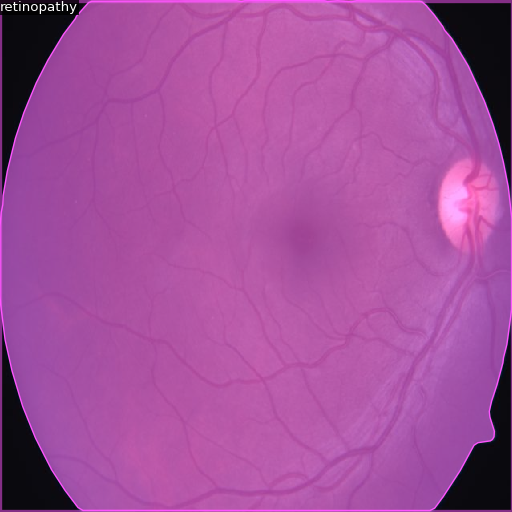

In [ ]:
metadata = MetadataCatalog.get(TRAIN_DATA_SET_NAME)
dataset_train = DatasetCatalog.get(TRAIN_DATA_SET_NAME)

dataset_entry = dataset_train[0]
image = cv2.imread(dataset_entry["file_name"])

visualizer = Visualizer(
    image[:, :, ::-1],
    metadata=metadata,
    scale=0.8,
    instance_mode=ColorMode.IMAGE_BW
)

out = visualizer.draw_dataset_dict(dataset_entry)
cv2_imshow(out.get_image()[:, :, ::-1])

## Train Model Using Custom COCO Format Dataset

### Configuration

In [ ]:
# HYPERPARAMETERS
ARCHITECTURE = "mask_rcnn_R_101_FPN_3x"
CONFIG_FILE_PATH = f"COCO-InstanceSegmentation/{ARCHITECTURE}.yaml"
MAX_ITER = 2000
EVAL_PERIOD = 200
BASE_LR = 0.001
NUM_CLASSES = 3

# OUTPUT DIR
OUTPUT_DIR_PATH = os.path.join(
    DATA_SET_NAME,
    ARCHITECTURE,
    datetime.now().strftime('%Y-%m-%d-%H-%M-%S')
)

os.makedirs(OUTPUT_DIR_PATH, exist_ok=True)

In [ ]:
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file(CONFIG_FILE_PATH))
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url(CONFIG_FILE_PATH)
cfg.DATASETS.TRAIN = (TRAIN_DATA_SET_NAME,)
cfg.DATASETS.TEST = (TEST_DATA_SET_NAME,)
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 64
cfg.TEST.EVAL_PERIOD = EVAL_PERIOD
cfg.DATALOADER.NUM_WORKERS = 2
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.INPUT.MASK_FORMAT='bitmask'
cfg.SOLVER.BASE_LR = BASE_LR
cfg.SOLVER.MAX_ITER = MAX_ITER
cfg.MODEL.ROI_HEADS.NUM_CLASSES = NUM_CLASSES
cfg.OUTPUT_DIR = OUTPUT_DIR_PATH

### Training

In [ ]:
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

[09/14 05:03:55 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_a3ec72.pkl: 254MB [00:01, 211MB/s]                           
roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}
roi_heads.mask_head.predictor.{bias, weight}


[09/14 05:03:56 d2.engine.train_loop]: Starting training from iteration 0
[09/14 05:04:09 d2.utils.events]:  eta: 0:17:05  iter: 19  total_loss: 2.632  loss_cls: 1.308  loss_box_reg: 0.6555  loss_mask: 0.6689  loss_rpn_cls: 0.0008038  loss_rpn_loc: 0.006465    time: 0.5248  last_time: 0.5848  data_time: 0.0281  last_data_time: 0.0363   lr: 1.9981e-05  max_mem: 2588M
[09/14 05:04:25 d2.utils.events]:  eta: 0:16:21  iter: 39  total_loss: 1.915  loss_cls: 0.7371  loss_box_reg: 0.6214  loss_mask: 0.4599  loss_rpn_cls: 0.0005905  loss_rpn_loc: 0.005534    time: 0.5052  last_time: 0.3955  data_time: 0.0189  last_data_time: 0.0140   lr: 3.9961e-05  max_mem: 2589M
[09/14 05:04:33 d2.utils.events]:  eta: 0:15:29  iter: 59  total_loss: 1.143  loss_cls: 0.3059  loss_box_reg: 0.5884  loss_mask: 0.2414  loss_rpn_cls: 0.001016  loss_rpn_loc: 0.004721    time: 0.4808  last_time: 0.4409  data_time: 0.0115  last_data_time: 0.0183   lr: 5.9941e-05  max_mem: 2589M
[09/14 05:04:42 d2.utils.events]:  eta: 

In [ ]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir $OUTPUT_DIR_PATH

<IPython.core.display.Javascript object>

### Evaluation

In [ ]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7
predictor = DefaultPredictor(cfg)

[09/14 05:19:55 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from retinopathy/mask_rcnn_R_101_FPN_3x/2023-09-14-05-03-53/model_final.pth ...


WARNING [09/14 05:19:56 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[09/14 05:19:56 d2.data.datasets.coco]: Loaded 96 images in COCO format from /content/retinopathy-1/valid/_annotations.coco.json


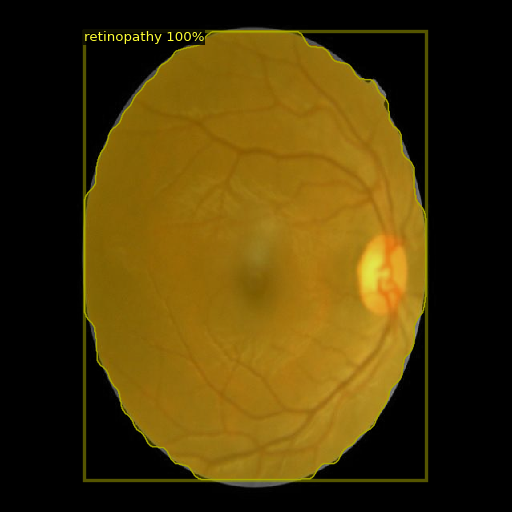

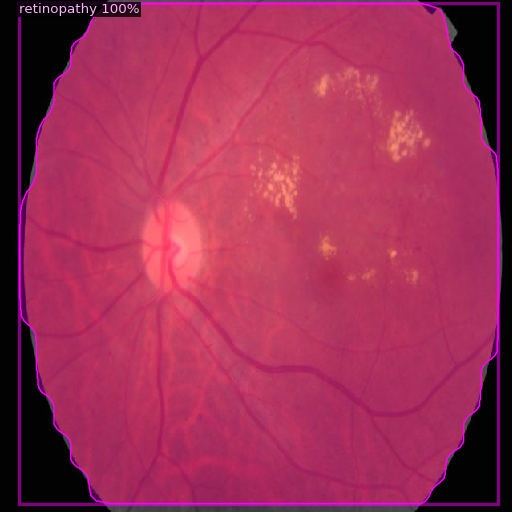

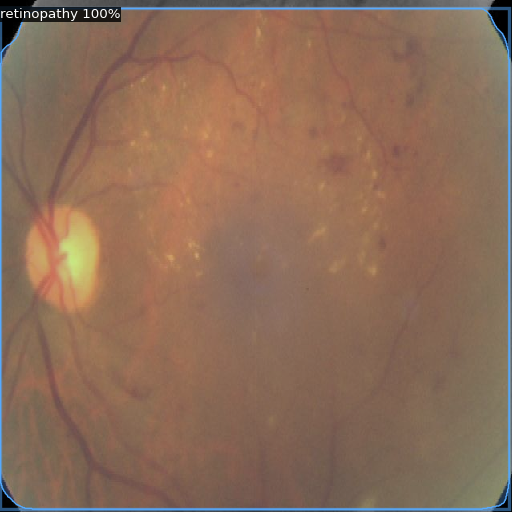

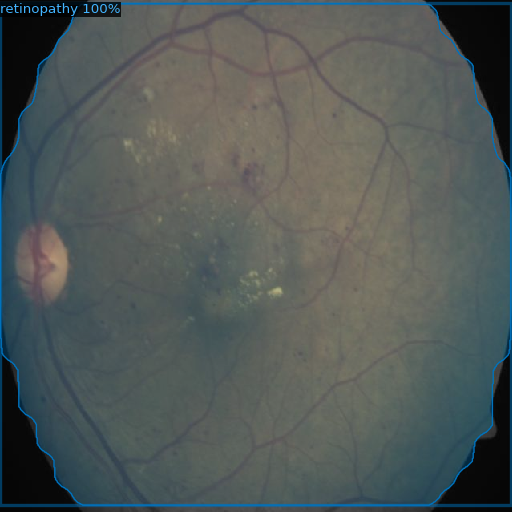

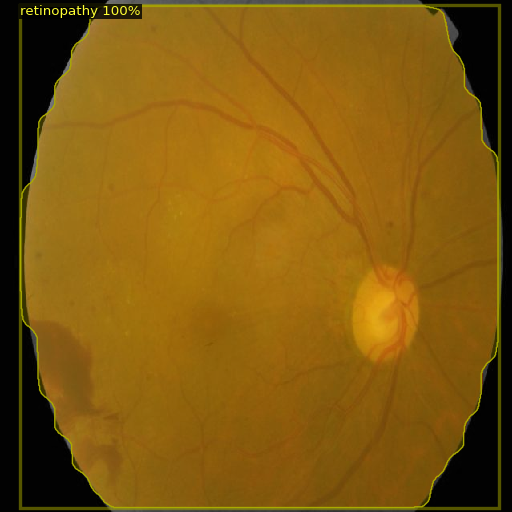

...

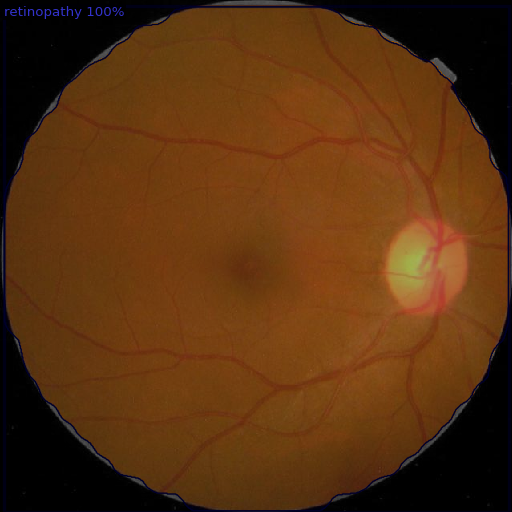

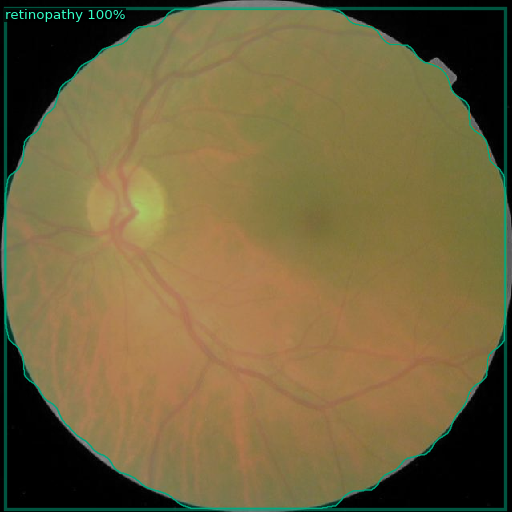

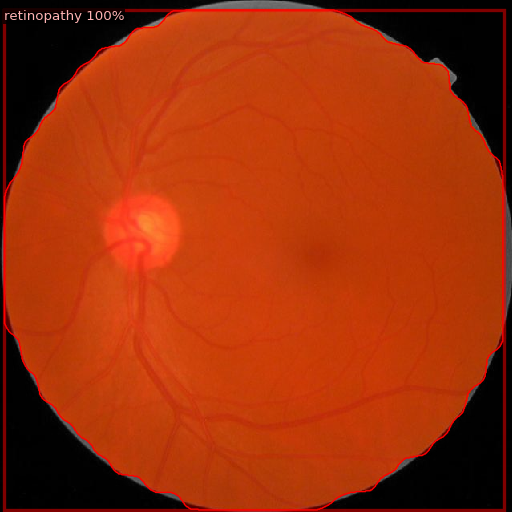

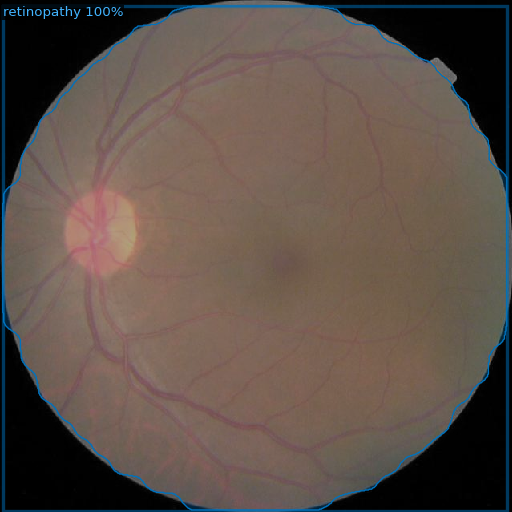

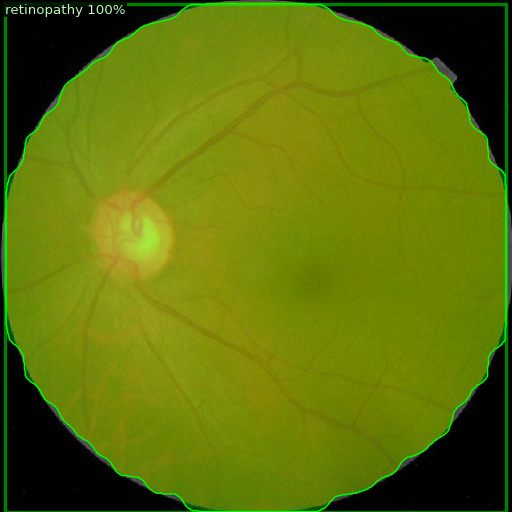

In [ ]:
dataset_valid = DatasetCatalog.get(VALID_DATA_SET_NAME)

for d in dataset_valid:
    img = cv2.imread(d["file_name"])
    outputs = predictor(img)

    visualizer = Visualizer(
        img[:, :, ::-1],
        metadata=metadata,
        scale=0.8,
        instance_mode=ColorMode.IMAGE_BW
    )
    out = visualizer.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])